---
<div class="alert alert-block alert-danger">

# **Multi-agent learning of a coordination problem (Q-Learning and Game Theory)**

---
<br>
    
#### **Created by**:
#### Name: Soh En Ming
#### Student ID: 32024975

<br>

#### Environment: **Python 3.11**
</div>

<div class="alert alert-block alert-info">
    
### **Table of Contents**

</div>

[1. Introduction](#1) <br>
[2. Importing Libraries](#2) <br>
[3. Environment Overview](#3) <br>
[4. Tabular Q-Learning Based Agent Class](#4) <br>
[5. Grid World Class](#5) <br>
[6. Training the Agent](#6) <br>
$\;\;\;\;$[6.1. Running the code](#6.1) <br>
$\;\;\;\;$[6.2. Analysis of results from training the Agent](#6.2) <br>
$\;\;\;\;$[6.3. Training Convergence Analysis](#6.3) <br>
$\;\;\;\;$[6.4. Hyperparameter Testing](#6.4) <br>
[7. Testing the Agent](#7) <br>
$\;\;\;\;$[7.1. Running the code](#7.1) <br>
$\;\;\;\;$[7.2. Analysis of results from testing the Agent](#7.2) <br>
$\;\;\;\;$[7.3. Testing Convergence Analysis](#7.3) <br>
[8. Trained Agent vs Naive](#8) <br>
$\;\;\;\;$[8.1. Running the code](#8.1) <br>
$\;\;\;\;$[8.2. Analysis of Results](#8.2) <br>
[9. Brief Discussion of Limitations, Future Improvements and Conclusion](#9) <br>
$\;\;\;\;$[9.1. Limitations and Future Improvements](#9.1) <br>
$\;\;\;\;$[9.2. Conclusion](#9.2) <br>
[10. References](#10) <br>

---
<div class="alert alert-block alert-success">
    
## **0. Contract**  <a class="anchor" name="1"></a>
---

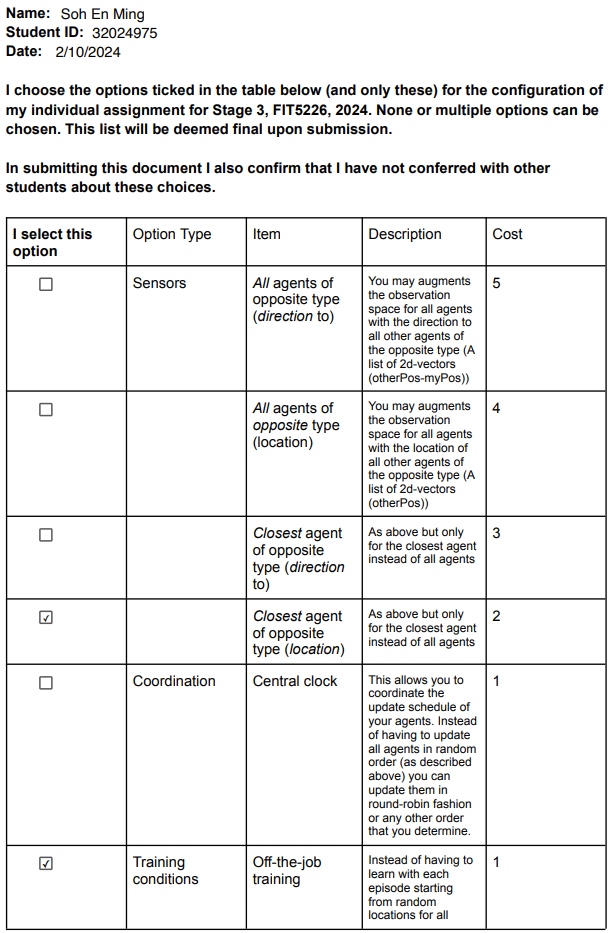

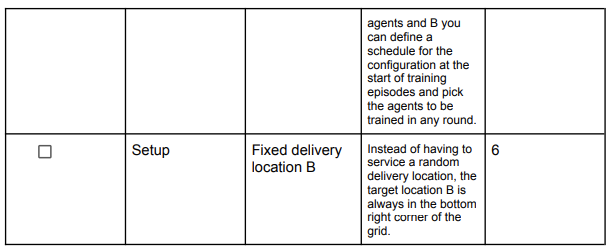

---
<div class="alert alert-block alert-success">
    
## **1.  Introduction**  <a class="anchor" name="1"></a>
---

The purpose of this project is to implement a multi-agent system using **Tabular Q-Learning** in a collaborative grid environment. The task focuses on optimizing the coordination of agents to complete a delivery mission by exchanging secrets and delivering an item to a designated target location. The agents operate in a **5x5 grid world**, with each agent having partial knowledge of the required information, necessitating cooperation between different types of agents.

In this environment, agents must learn optimal policies through **reinforcement learning**, specifically using Tabular Q-Learning, where the objective is to maximize cumulative rewards by taking actions that result in effective collaboration and minimal steps. This project builds on prior stages, transitioning from **Deep Q-Networks (DQN)** to Tabular Q-Learning, while maintaining the core mechanics of coordination and learning.

The implementation evaluates the performance of the agents by tracking metrics such as total steps, rewards per episode, success rate, and excess path length, while visualizing the agents' paths to aid in understanding their learning behavior. Through this project, we aim to analyse how agents adapt their strategies over time, improving their efficiency in completing the task.

---

<div class="alert alert-block alert-success">
    
## **2.  Importing Libraries**  <a class="anchor" name="2"></a>

---


In this assessment, the following packages were used to accomplish the related tasks:

* **random:** For generating random numbers (e.g., initializing agent and target positions).
* **numpy:** For numerical computing, array operations, and mathematical functions.
* **matplotlib.pyplot:** For creating static, interactive, and animated visualizations of the grid world and agent movements.
* **matplotlib.patches:** For adding shapes (e.g., rectangles, circles) to plots to represent agents and the target.
* **matplotlib.animation:** For creating animations to visualize agent movements over time.
* **ipywidgets:** For creating interactive widgets in Jupyter notebooks.
* **IPython.display:** For displaying interactive visualizations and HTML content in Jupyter notebooks.
* **collections:** For implementing a deque (double-ended queue) if needed for the replay buffer (not explicitly used in the provided code).
* **copy:** For creating deep copies of objects (if needed to avoid unintended modifications).
* **tabulate:** For creating pretty tables.
* **plotly:** For interactive graphs.

In [ ]:
!pip install plotly

In [ ]:
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import animation
from matplotlib.patches import Patch
import ipywidgets as widgets
from IPython.display import display, HTML
import pandas as pd
from tabulate import tabulate
import plotly.graph_objects as go
import os

---
<div class="alert alert-block alert-success">
    
## **3. Environment Overview** <a class="anchor" name="3"></a>
---

The environment for this project is a 5x5 grid world designed for multi-agent collaboration. Each agent in the grid is assigned a task to deliver an item to a target location (referred to as **Target B**). However, the agents can only access **Target B** after fully exchanging secrets with another agent of the opposite type.

The environment includes the following key components:

- **Grid Structure:** The grid is a 5x5 square, where agents are randomly initialized at the start of each episode. The target location is also placed randomly, ensuring variability in each episode.
  
- **Agents:** There are four agents in total, divided into two types:
  - **Type 1 Agents:** Agents 0 and 1.
  - **Type 2 Agents:** Agents 2 and 3.
  
  Each agent has partial knowledge of a secret, and the two agent types must meet to exchange information before they can access the target location. Only after a successful exchange of secrets can an agent deliver the item.

- **Actions:** Agents can take the following actions:
  - **North, South, East, West:** Moving in the respective direction by one grid cell.
  - **Wait:** The agent stays in place but may wait for the other agent during the coordination process.

- **Secret Exchange and Delivery Mechanism:** To successfully deliver the item to **Target B**, agents must first meet and exchange secrets. The environment tracks the location of each agent, the possession of secrets, and whether the agent has access to the target. Once an agent has the full secret, it can proceed to deliver the item at **Target B**.

- **Reward System:** Agents are rewarded or penalized based on their actions:
  - Positive rewards are given for moving closer to the target or the closest opposite-type agent.
  - Negative rewards are applied for oscillatory movements (e.g., moving back and forth), attempting to deliver the item without the full secret, or inefficient movements.

- **Termination Conditions:** An episode ends either when an agent successfully delivers the item to **Target B** after exchanging secrets or when the maximum number of steps (50) is reached.

This environment is designed to encourage cooperation, strategic movement, and optimal decision-making, as agents must learn not only to navigate the grid but also to coordinate with each other in the shortest possible path while maximizing rewards. The randomness in agent and target positions creates diverse scenarios that challenge the agents' learning process over multiple episodes.

---
<div class="alert alert-block alert-success">
    
## **4. Tabular Q-Learning Based Agent Class** <a class="anchor" name="4"></a>
---

In this project, each agent is implemented using **Tabular Q-learning**, which is a reinforcement learning (RL) method that allows agents to learn an optimal policy for decision-making. The agent class uses a Q-table to store and update Q-values for each state-action pair based on the feedback (reward) from the environment.

#### Key Components:
- **Q-Table:** A lookup table where rows represent states, and columns represent actions. The values in the table represent the agent's estimate of the expected future rewards (Q-values) for taking a certain action in a given state.
  
- **Learning Parameters:**
  - **Alpha (α):** The learning rate that controls how much new information overrides old information in the Q-values.
  - **Gamma (γ):** The discount factor that weighs the importance of future rewards versus immediate rewards.
  - **Epsilon (ε):** The exploration-exploitation parameter, used in the ε-greedy strategy. With probability ε, the agent explores by taking a random action, and with probability (1 - ε), it exploits by choosing the action with the highest Q-value.

#### Training Process:
- **Action Selection:** The agent chooses actions based on the ε-greedy policy, meaning it occasionally explores by taking random actions but generally selects the action with the highest Q-value for the current state.
  
- **Q-Value Update:** After taking an action and receiving a reward from the environment, the Q-value for that state-action pair is updated using the Q-learning update rule:

  $
  Q(s, a) \leftarrow Q(s, a) + \alpha \left[ r + \gamma \max_a Q(s', a') - Q(s, a) \right]
  $

  This update process allows the agent to iteratively improve its estimate of the optimal policy over multiple episodes.

### Why Tabular Q-Learning was Used Instead of DQN

In earlier stages, a **Deep Q-Network (DQN)** was considered and implemented. However, for Stage 3, **Tabular Q-learning** was chosen over DQN for several reasons:

1. **State and Action Space Simplicity:** The state space in this grid-world task is relatively small, with discrete states and actions. Tabular Q-learning is well-suited for such environments, where it is computationally feasible to store a Q-value for each state-action pair directly in a table. In contrast, DQN is more appropriate for large or continuous state spaces where representing each state-action pair in a table is impractical.

2. **Simplicity and Interpretability:** Tabular Q-learning is simpler to implement, understand, and debug compared to DQN, which requires more complex components like neural networks and experience replay. The simplicity of Tabular Q-learning makes it ideal for educational environments or tasks with clear, discrete state-action spaces.

3. **Training Efficiency:** Given the relatively small size of the grid world, Tabular Q-learning converges faster than DQN, which involves training a neural network with many episodes to achieve similar performance.

4. **Overhead of DQN:** DQN introduces additional computational overhead, requiring the tuning of neural network architectures, optimization routines, and replay buffers. For the small grid-world environment, this overhead is unnecessary, and Tabular Q-learning provides an efficient and optimal solution with minimal complexity.

In summary, **Tabular Q-learning** was chosen because it provides a simpler, more efficient solution for this environment without sacrificing performance.

In [ ]:
class QLearningAgent:
    """
    A Q-Learning agent that interacts with the GridWorld environment.

    This agent implements a tabular Q-learning approach with an epsilon-greedy
    policy for action selection. It learns by updating Q-values based on
    state-action-reward transitions.
    """

    def __init__(self, agent_type, grid_size, alpha=0.1, gamma=0.9, epsilon=0.1, num_actions=5):
        """
        Initializes the Q-learning agent with the given hyperparameters.

        Args:
            agent_type (int): Type of the agent (1 for Type 1, 2 for Type 2).
            grid_size (int): The size of the grid world (e.g., 5x5).
            alpha (float): Learning rate (default: 0.1).
            gamma (float): Discount factor for future rewards (default: 0.9).
            epsilon (float): Epsilon for epsilon-greedy action selection (default: 0.1).
            num_actions (int): Number of possible actions for the agent (default: 5).
        """
        # Store agent type (1 or 2) and other learning hyperparameters.
        self.agent_type = agent_type
        self.grid_size = grid_size
        self.alpha = alpha  # Learning rate: How much we value new information.
        self.gamma = gamma  # Discount factor: How much we prioritize future rewards.
        self.epsilon = epsilon  # Exploration-exploitation trade-off.
        self.num_actions = num_actions

        # Initialize the Q-Table for this agent.
        self.q_table = self.initialize_q_table()

    def initialize_q_table(self):
        """
        Initializes the Q-Table for all possible states.

        The state includes the agent's position, the target's position,
        possession of the secret, and the relative position of the closest
        opposite agent.

        Returns:
            dict: Q-Table initialized to zero for all state-action pairs.
        """
        q_table = {}
        # Iterate over all possible combinations of the agent and target positions
        for x in range(self.grid_size):
            for y in range(self.grid_size):
                for b_x in range(self.grid_size):
                    for b_y in range(self.grid_size):
                        for possession in [0, 1]:  # 0: Doesn't have the full secret, 1: Has full secret.
                            for rel_position in ['near', 'far']:  # Relative position of closest opposite agent.
                                state = ((x, y), (b_x, b_y), possession, rel_position)
                                q_table[state] = [0] * self.num_actions  # Initialize Q-values for all actions to 0.
        return q_table

    def choose_action(self, state):
        """
        Selects an action based on the epsilon-greedy policy.

        With probability epsilon, the agent will explore (choose a random action),
        otherwise, it will exploit (choose the best-known action).

        Args:
            state (tuple): The current state of the agent.

        Returns:
            int: The index of the chosen action.
        """
        # If random number is less than epsilon, choose a random action (exploration).
        if random.uniform(0, 1) < self.epsilon:
            return random.randint(0, self.num_actions - 1)
        # Otherwise, choose the action with the highest Q-value (exploitation).
        else:
            return np.argmax(self.q_table[state])

    def update_q_value(self, state, action, reward, next_state):
        """
        Updates the Q-value for the given state-action pair based on the reward and next state.

        The Q-value is updated using the Bellman equation:
        Q(s, a) = Q(s, a) + alpha * [reward + gamma * max(Q(next_state)) - Q(s, a)].

        Args:
            state (tuple): The current state of the agent.
            action (int): The action taken by the agent.
            reward (float): The reward received for taking the action.
            next_state (tuple): The state the agent transitions to after taking the action.
        """
        # Calculate the maximum Q-value for the next state (best future action).
        max_q_next = max(self.q_table[next_state])
        # Update the Q-value for the current state-action pair using the Q-learning formula.
        self.q_table[state][action] += self.alpha * (reward + self.gamma * max_q_next - self.q_table[state][action])

---
<div class="alert alert-block alert-success">
    
## **5.  Grid World Class** <a class="anchor" name="5"></a>
---

The **Grid World** environment used in this project is a 5x5 grid where multiple agents interact to achieve a shared goal of delivering an item to a target location, **B**. The agents are divided into two types (Type 1 and Type 2), and they must collaborate to exchange parts of a secret before delivering the item. Each type of agent knows only part of the secret, so the agents must meet, exchange information, and coordinate before one can successfully deliver the item to location **B**.

#### **Key Components:**
1. **Grid Representation:** The grid is represented as a 5x5 matrix where each cell corresponds to a position on the grid. The agents are initialized at random positions, and the target location **B** is also randomly placed in the grid. Agents must navigate the grid by selecting actions to move north, south, east, west, or stay in place (wait).

2. **Agents:** There are four agents in total (two of each type), each of which has an initial position and a partial secret. Agents must move toward each other to exchange information before one of them can proceed to deliver the item at **B**. Each agent is controlled by a Tabular Q-learning algorithm that allows it to learn an optimal movement policy.

3. **Actions and Rewards:**
   - Agents can take actions to move in the grid (north, south, east, west, or wait).
   - The reward system encourages movement toward the target and discourages unnecessary backtracking. Agents are penalized for moving away from their goal or attempting to access the target before obtaining the full secret.
   - When agents meet and exchange secrets, they are rewarded for coordinating successfully.

4. **Secret Exchange Mechanism:** Agents can only deliver the item if they possess the full secret, which requires them to meet an opposite-type agent. This exchange is critical and must happen before one of the agents can access the target **B**.

5. **Episode Loop:** The environment is reset at the beginning of each episode, with agents and the target placed randomly on the grid. Agents then take turns, in random order, selecting actions based on their learned policies. The episode continues until an agent successfully delivers the item or the maximum number of steps is reached.

6. **Training and Testing:** The environment includes methods for training agents over multiple episodes, as well as testing the learned policies. During training, agents update their Q-values based on the rewards received from the environment. During testing, the agents' performance is evaluated without further learning, and metrics like success rate, excess path length, and steps per episode are recorded.

In summary, the **Grid World** code implements a cooperative multi-agent environment where agents must coordinate and learn to navigate a grid, exchange information, and deliver an item to a target location efficiently using Tabular Q-learning. <br><br>

####**Performance Metrics and Their Importance**

In evaluating the performance of multi-agent Q-Learning tasks, selecting relevant metrics provides insight into the effectiveness of agents and the quality of learned policies. This project tracked several key metrics during both training and testing phases to assess agent performance and efficiency in achieving objectives.

1. **Performance Level (Success Rate)**: The success rate is the percentage of episodes where agents completed the task in fewer than a specified threshold of steps. This metric is crucial as it indicates how often the agents are able to solve the task within efficient parameters, showing how effectively they learn to cooperate in reaching the goal.

2. **Average Steps per Episode**: This metric averages the steps taken by all agents across episodes, allowing us to evaluate overall agent efficiency. Lower average steps suggest that agents are learning optimal policies that minimize unnecessary movements, a key aspect of achieving high performance in tasks with step constraints.

3. **Average Excess Path Length**: Tracking the excess path length — the difference between the actual path length and the ideal path length — highlights the gap between the current policy’s effectiveness and the best-known path. Minimizing this excess path length is particularly relevant in coordination tasks, where unnecessary movements can detract from overall task efficiency.

4. **Average Reward per Episode**: The average reward provides a general indication of the quality of the agents' actions. Higher average rewards signal that agents are maximizing positive actions while minimizing penalties, which reflects an effective learning process in reinforcement learning environments.

Each of these metrics together provides a comprehensive view of agent performance, enabling an understanding of not just task success but also efficiency, learning quality, and consistency in policy execution.


In [ ]:
class GridWorld:
    """
    A multi-agent grid world environment where agents collaborate to deliver an item to a target location B.
    Agents must exchange secrets with opposite-type agents before accessing the target.

    This environment supports Q-Learning agents with a 5x5 grid and includes secret sharing, movement, and
    delivery logic. It also tracks agent positions and rewards based on the defined rules.

    Attributes:
        grid_size (int): Size of the grid world (default: 5x5).
        num_agents (int): Number of agents in the environment (default: 4).
        alpha (float): Learning rate for Q-Learning agents.
        gamma (float): Discount factor for future rewards.
        epsilon (float): Exploration-exploitation trade-off parameter for epsilon-greedy policy.
        max_steps (int): Maximum number of steps per episode.
        agent_types (dict): A dictionary mapping agent IDs to their types (Type 1 or Type 2).
        agent_positions (dict): A dictionary tracking the positions of agents.
        target_position (tuple): The position of the target location B.
        secrets (dict): A dictionary tracking whether each agent has the full secret.
        actions (list): List of possible actions (north, south, west, east, wait).
        q_agents (dict): A dictionary of Q-Learning agents for both agent types (Type 1 and Type 2).
    """

    def __init__(self, grid_size=5, num_agents=4, alpha=0.1, gamma=0.9, epsilon=0.1, max_steps=50):
        """
        Initializes the GridWorld environment with the specified parameters.

        Args:
            grid_size (int): The size of the grid (default: 5x5).
            num_agents (int): Number of agents in the environment (default: 4).
            alpha (float): Learning rate for Q-Learning (default: 0.1).
            gamma (float): Discount factor for future rewards (default: 0.9).
            epsilon (float): Exploration-exploitation trade-off (default: 0.1).
            max_steps (int): Maximum number of steps per episode (default: 50).
        """
        self.grid_size = grid_size
        self.num_agents = num_agents
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.max_steps = max_steps

        self.agent_types = {1: 'Type 1', 2: 'Type 2'}  # Mapping for agent types
        self.agent_positions = {}  # Tracks each agent's position in the grid
        self.target_position = None  # The target position (B) agents must reach
        self.secrets = {}  # Tracks if agents possess the full secret
        self.actions = ['north', 'south', 'west', 'east', 'wait']  # List of possible actions
        self.num_actions = len(self.actions)  # Number of actions available

        # Initialize two Q-Learning agents (one for each type)
        self.q_agents = {
            1: QLearningAgent(1, self.grid_size, alpha, gamma, epsilon, self.num_actions),
            2: QLearningAgent(2, self.grid_size, alpha, gamma, epsilon, self.num_actions)
        }

        # Reset the environment for the initial setup
        self.reset()

    def get_agent_type(self, agent_id):
        """
        Returns the agent type (1 or 2) based on the agent's ID.

        Args:
            agent_id (int): The ID of the agent.

        Returns:
            int: The type of the agent (1 for Type 1 agents, 2 for Type 2 agents).
        """
        return 1 if agent_id < self.num_agents // 2 else 2

    def reset(self):
        """
        Resets the environment, randomizing agent positions and the target location.
        Ensures that no agent starts at the target location (B).

        Returns:
            dict: The initial state of all agents, including positions, target location, and secret possession.
        """
        self.agent_positions = {}
        self.initial_agent_positions = {}  # To store the initial position of each agent

        # Randomly initialize agent positions
        for i in range(self.num_agents):
            while True:
                position = (random.randint(0, self.grid_size - 1), random.randint(0, self.grid_size - 1))
                if position not in self.agent_positions.values() and position != self.target_position:
                    # Ensure agents don't start at the same position or at target B
                    self.agent_positions[i] = position
                    self.initial_agent_positions[i] = position  # Store initial position
                    break

        # Initialize the possession of secrets for all agents (0: no secret, 1: has full secret)
        self.secrets = {i: 0 for i in range(self.num_agents)}

        # Randomly place the target location B, ensuring it doesn't overlap with agent positions
        while True:
            self.target_position = (random.randint(0, self.grid_size - 1), random.randint(0, self.grid_size - 1))
            if self.target_position not in self.agent_positions.values():
                break

        # Return the state of all agents after resetting
        return self.get_all_states()

    def get_all_states(self):
        """
        Retrieves the current state for all agents in the environment.

        The state includes the agent's position, the target's position, whether they possess the full secret,
        and the relative position (near/far) of the closest opposite agent.

        Returns:
            dict: The current state of all agents in the form {agent_id: state}.
        """
        states = {}
        for agent_id, position in self.agent_positions.items():
            # Find the closest opposite-type agent to the current agent
            closest_opposite_agent = self.find_closest_opposite_agent(agent_id, self.get_agent_type(agent_id))
            relative_position = None
            if closest_opposite_agent is not None:
                closest_position = self.agent_positions[closest_opposite_agent]
                # Calculate Manhattan distance to the closest opposite agent
                distance_to_closest = abs(closest_position[0] - position[0]) + abs(closest_position[1] - position[1])
                # Classify the distance as 'near' or 'far'
                relative_position = 'near' if distance_to_closest <= 2 else 'far'

            # Store state: (agent_position, target_position, secret possession, relative position)
            states[agent_id] = (position, self.target_position, self.secrets[agent_id], relative_position)

        return states

    def find_closest_opposite_agent(self, agent_id, agent_type):
        """
        Finds the closest agent of the opposite type to the given agent.
        Args:
            agent_id (int): The ID of the agent.
            agent_type (int): The type of the agent (1 or 2).

        Returns:
            int: The ID of the closest agent of the opposite type.
        """
        min_distance = float('inf')
        closest_agent_id = None
        current_position = self.agent_positions[agent_id]

        for other_agent_id, other_position in self.agent_positions.items():
            if self.get_agent_type(other_agent_id) != agent_type:
                # Calculate Manhattan distance to the other agent
                distance = abs(current_position[0] - other_position[0]) + abs(current_position[1] - other_position[1])

                # Check if this is the closest agent so far
                if distance < min_distance:
                    min_distance = distance
                    closest_agent_id = other_agent_id
        return closest_agent_id

    def step(self, agent_id, action, previous_position):
        """
        Executes an action for a given agent and updates the environment.

        Args:
            agent_id (int): The ID of the agent performing the action.
            action (int): The action index (0: 'north', 1: 'south', 2: 'west', 3: 'east', 4: 'wait').
            previous_position (tuple): The position of the agent before taking the action.

        Returns:
            tuple: (new_state, reward, done, info)
                new_state (tuple): The updated state of the agent.
                reward (float): Reward received for the action.
                done (bool): Whether the episode is completed.
                info (dict): Additional information (empty in this case).
        """
        current_position = self.agent_positions[agent_id]
        new_position = self.get_new_position(current_position, action)

        # Check if the agent is attempting to reach B without the full secret
        if new_position == self.target_position and self.secrets[agent_id] == 0:
            new_position = current_position  # Prevent the move if the secret is missing
            reward = -10  # Penalize for attempting to reach B without the secret
        else:
            # Check if the new position is valid within the grid
            if self.is_valid_position(new_position):
                self.agent_positions[agent_id] = new_position

            # Penalize repetitive back-and-forth movements
            reward = -20 if new_position == previous_position else -1  # Stronger penalty for oscillation

        # Reward for moving closer to the closest opposite agent before exchanging secrets
        closest_opposite_agent_id = self.find_closest_opposite_agent(agent_id, self.get_agent_type(agent_id))
        closest_opposite_position = self.agent_positions[closest_opposite_agent_id]
        current_distance_to_opposite = max(abs(new_position[0] - closest_opposite_position[0]),
                                           abs(new_position[1] - closest_opposite_position[1]))
        previous_distance_to_opposite = max(abs(previous_position[0] - closest_opposite_position[0]),
                                            abs(previous_position[1] - closest_opposite_position[1]))

        if self.secrets[agent_id] == 0:
            if current_distance_to_opposite < previous_distance_to_opposite:
                reward += 5  # Reward for moving closer to the opposite agent
            elif current_distance_to_opposite > previous_distance_to_opposite:
                reward -= 5  # Penalty for moving away

        # Check if agents meet to exchange secrets
        if self.secrets[agent_id] == 0:
            self.check_meeting(agent_id)

        # Reward moving toward B after obtaining the full secret
        if self.secrets[agent_id] == 1:
            previous_distance_to_B = max(abs(previous_position[0] - self.target_position[0]),
                                         abs(previous_position[1] - self.target_position[1]))
            new_distance_to_B = max(abs(new_position[0] - self.target_position[0]),
                                    abs(new_position[1] - self.target_position[1]))

            reward += 5 if new_distance_to_B < previous_distance_to_B else -5  # Reward/penalty for proximity to B

        # Check if agent delivers the item to B
        reward_delivery, done = self.check_delivery(agent_id)
        reward += reward_delivery  # Add the delivery reward if applicable

        # Get the updated state and return the result
        new_state = self.get_all_states()[agent_id]
        return new_state, reward, done, {}

    def get_new_position(self, position, action):
        """
        Calculates the new position of an agent after performing an action.

        Args:
            position (tuple): The current position of the agent (x, y).
            action (int): The action to be performed (0: 'north', 1: 'south', 2: 'west', 3: 'east', 4: 'wait').

        Returns:
            tuple: The new position (x, y).
        """
        x, y = position
        if action == 0:  # Move north
            return (x, y - 1)
        elif action == 1:  # Move south
            return (x, y + 1)
        elif action == 2:  # Move west
            return (x - 1, y)
        elif action == 3:  # Move east
            return (x + 1, y)
        elif action == 4:  # Wait
            return (x, y)  # No movement

    def is_valid_position(self, position):
        """
        Validates whether the given position is within the grid boundaries.

        Args:
            position (tuple): Position (x, y) to be validated.

        Returns:
            bool: True if the position is within the grid, False otherwise.
        """
        x, y = position
        return 0 <= x < self.grid_size and 0 <= y < self.grid_size

    def check_meeting(self, agent_id):
        """
        Checks if the agent meets an opposite-type agent to exchange secrets.

        Args:
            agent_id (int): The ID of the agent.

        If both agents are at the same position and are of opposite types, they exchange secrets.
        """
        agent_type = self.get_agent_type(agent_id)
        current_position = self.agent_positions[agent_id]

        for other_agent_id, other_position in self.agent_positions.items():
            # Skip if they are the same agent, same type, or at B, or have the full secret
            if (agent_id == other_agent_id or self.get_agent_type(other_agent_id) == agent_type or
                    current_position == self.target_position or self.secrets[agent_id] == 1 or
                    self.secrets[other_agent_id] == 1):
                continue

            # If they meet at the same position (excluding B), exchange secrets
            if current_position == other_position:
                self.secrets[agent_id] = 1
                self.secrets[other_agent_id] = 1

    def check_delivery(self, agent_id):
        """
        Checks if the agent successfully delivers the item to the target (B).

        Args:
            agent_id (int): The ID of the agent.

        Returns:
            tuple: (reward, done), where:
                - reward (int): The reward for the delivery (100 for success, -50 for failure, -1 for regular moves).
                - done (bool): Whether the episode is completed (True if delivery is successful).
        """
        if self.agent_positions[agent_id] == self.target_position:
            if self.secrets[agent_id] == 1:
                return 100, True  # Success: delivered with the full secret
            else:
                return -50, False  # Penalty: reached B without the secret
        return -1, False  # Standard reward for non-delivery moves

    def visualize_paths(self, paths, env, episode_num=None, agent_order_list=None, save_as_html=False, save_path=None, total_steps=None, total_reward=None, total_ideal_steps=None):
        """
        Visualizes the paths of agents in the grid during an episode.

        Args:
            paths (dict): A dictionary where keys are agent IDs and values are lists of (x, y) positions.
            env (GridWorld): The environment object to access agent states and the grid.
            episode_num (int, optional): The current episode number (used for labeling). Defaults to None.
            agent_order_list (list, optional): A list of the random order in which agents acted during each step. Defaults to None.
            save_as_html (bool, optional): Whether to save the visualization as an HTML file. Defaults to False.
            save_path (str, optional): Path to save the HTML file if save_as_html is True. Defaults to None.
            total_steps (int, optional): Total number of steps taken in the episode. Defaults to None.
            total_reward (float, optional): Total reward obtained in the episode. Defaults to None.
            total_ideal_steps (int, optional): Ideal number of steps calculated for the episode. Defaults to None.

        This method visualizes the agents' movements over time, their initial positions, and the final location (target B).
        It also animates the movement of each agent step by step.
        """
        fig, ax = plt.subplots(figsize=(10, 6))

        # Draw grid lines
        grid_size = env.grid_size
        for x in range(grid_size + 1):
            ax.plot([x, x], [0, grid_size], color='black')
            ax.plot([0, grid_size], [x, x], color='black')

        # Draw the target B location as a red square
        target_B = env.target_position
        ax.add_patch(patches.Rectangle((target_B[1], target_B[0]), 1, 1, fill=True, color='red', label='Target B'))

        # Initialize colors and patches for each agent
        agent_colors = {0: 'blue', 1: 'purple', 2: 'green', 3: 'orange'}
        agent_patches = {}

        # Draw initial positions of agents using different shapes
        for agent_id, path in paths.items():
            agent_type = env.get_agent_type(agent_id)
            color = agent_colors.get(agent_id, 'black')  # Default to black if agent_id not in dictionary
            start_pos = path[0]

            if agent_type == 1:
                # Type 1 agents are triangles
                patch = ax.add_patch(patches.RegularPolygon((start_pos[1] + 0.5, start_pos[0] + 0.5), numVertices=3, radius=0.5, orientation=np.pi/2, color=color, label=f'Agent {agent_id}'))
            else:
                # Type 2 agents are circles
                patch = ax.add_patch(patches.Circle((start_pos[1] + 0.5, start_pos[0] + 0.5), 0.3, color=color, label=f'Agent {agent_id}'))

            agent_patches[agent_id] = patch

        # Set grid aspect ratio and plot limits
        ax.set_aspect('equal')
        ax.set_xlim(0, grid_size)
        ax.set_ylim(0, grid_size)

        # Create custom labels for agents and target
        custom_labels = ['Agent 0 (Type 1)', 'Agent 1 (Type 1)', 'Agent 2 (Type 2)', 'Agent 3 (Type 2)', 'Target B']
        target_patch = patches.Patch(color='red', label='Target B')

        # Add a legend to explain agent symbols and the target
        plt.legend(handles=[agent_patches[0], agent_patches[1], agent_patches[2], agent_patches[3], target_patch],
                  labels=custom_labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Agents", title_fontsize="13",
                  fontsize="10", fancybox=True, shadow=False, framealpha=0.5, edgecolor="black")

        # Initialize storage for arrows representing agent movements
        arrows = []

        # Calculate total frames for animation (one frame per agent move)
        max_steps = max([len(path) for path in paths.values()])
        total_frames = (max_steps * len(paths)) - 3

        def update(frame):
            """Updates the animation frame to visualize agent movements step by step."""
            nonlocal arrows

            # Remove old arrows to show new movements
            for arrow in arrows:
                arrow.remove()
            arrows = []  # Clear arrows

            if frame == 0:
                # Display the initial positions of all agents
                for agent_id, path in paths.items():
                    initial_pos = path[0]
                    if env.get_agent_type(agent_id) == 1:
                        agent_patches[agent_id].remove()
                        agent_patches[agent_id] = ax.add_patch(patches.RegularPolygon((initial_pos[1] + 0.5, initial_pos[0] + 0.5), numVertices=6, radius=0.3, orientation=0, color=agent_colors[agent_id]))
                    else:
                        agent_patches[agent_id].set_center((initial_pos[1] + 0.5, initial_pos[0] + 0.5))

                ax.set_title(f"Episode {episode_num if episode_num else ''}: Step 0/{max_steps - 1}")
                return *agent_patches.values(), *arrows

            step = (frame - 1) // len(paths)  # Determine the current step for all agents
            agent_idx = (frame - 1) % len(paths)  # Determine which agent to move in this frame
            current_agent_order = agent_order_list[step]  # Get the random agent order for this step

            # Update the current agent's position
            current_agent_id = current_agent_order[agent_idx]
            if step < len(paths[current_agent_id]) - 1:  # Ensure the step is within the path length
                current_pos = paths[current_agent_id][step + 1]

                if env.get_agent_type(current_agent_id) == 1:
                    agent_patches[current_agent_id].remove()
                    agent_patches[current_agent_id] = ax.add_patch(patches.RegularPolygon((current_pos[1] + 0.5, current_pos[0] + 0.5), numVertices=6, radius=0.3, orientation=0, color=agent_colors[current_agent_id]))
                else:
                    agent_patches[current_agent_id].set_center((current_pos[1] + 0.5, current_pos[0] + 0.5))

                # Add arrows to indicate movement direction
                previous_pos = paths[current_agent_id][step]
                dx = current_pos[1] - previous_pos[1]
                dy = current_pos[0] - previous_pos[0]
                arrow = ax.arrow(previous_pos[1] + 0.5, previous_pos[0] + 0.5, dx, dy, head_width=0.3, head_length=0.3, fc=agent_colors[current_agent_id], ec='black', alpha=0.7)
                arrows.append(arrow)

            ax.set_title(f"Episode {episode_num if episode_num else ''}: Step {step + 1}/{max_steps - 1}")
            return *agent_patches.values(), *arrows

        ani = animation.FuncAnimation(fig, update, frames=total_frames, interval=500, blit=True)

        if save_as_html and save_path:
            # Save the animation as HTML if specified
            episode_details = f"<h2>Episode {episode_num}: Total Steps = {total_steps}, Total Reward = {total_reward}, Ideal Path Length = {total_ideal_steps}</h2>"
            animation_html = ani.to_jshtml()

            # Combine episode details with the animation
            with open(save_path, 'w') as f:
                f.write(episode_details + animation_html)

        plt.close(fig)


    def collect_paths(self, num_episodes=1):
        """
        Collects the movement paths of all agents during multiple episodes.

        Args:
            num_episodes (int): Number of episodes to run and collect paths for.

        Returns:
            list: A list of dictionaries where each dictionary contains paths of agents for one episode.
                  The keys are agent IDs and the values are lists of (x, y) positions.
        """
        all_paths = []  # Stores paths for each episode

        for episode in range(num_episodes):
            # Reset environment for a new episode
            states = self.reset()
            paths = {agent_id: [self.agent_positions[agent_id]] for agent_id in self.agent_positions}
            done = False
            step_count = 0

            while not done and step_count < self.max_steps:
                step_count += 1

                # Randomize the agent order for this step
                agent_order = list(self.agent_positions.keys())
                random.shuffle(agent_order)

                for agent_id in agent_order:
                    state = states[agent_id]
                    agent_type = self.get_agent_type(agent_id)
                    action = self.q_agents[agent_type].choose_action(state)

                    # Execute the action and observe the new state
                    next_state, _, done, _ = self.step(agent_id, action, self.agent_positions[agent_id])
                    states[agent_id] = next_state

                    # Append the new position to the agent's path
                    paths[agent_id].append(self.agent_positions[agent_id])

                    if done:
                        break

            all_paths.append(paths)  # Store the paths of this episode

        return all_paths

    def calculate_ideal_path_with_exchange(self, successful_agent_id):
        """
        Calculate the ideal path for the successful agent to complete delivery after exchanging secrets
        with the closest opposite agent, ensuring the meeting point is as close to the target as possible.

        Args:
            successful_agent_id (int): The ID of the successful agent (the one that will deliver).

        Returns:
            tuple: The total number of steps in the ideal path, meeting steps, and target steps.
        """
        successful_agent_position = self.initial_agent_positions[successful_agent_id]
        target_position = self.target_position

        #print(f"\n[DEBUG] Successful Agent ID: {successful_agent_id}")

        # Determine opposite agents based on the type of the successful agent
        if successful_agent_id in [0, 1]:  # Successful agent is Type A
            opposite_agents = [2, 3]  # Opposite agents are Type B
        else:  # Successful agent is Type B
            opposite_agents = [0, 1]  # Opposite agents are Type A

        # Find the closest opposite agent based on Manhattan distance
        best_opposite_agent = None
        min_total_distance = float('inf')
        min_meeting_steps = float('inf')  # Tiebreaker by meeting steps

        for agent_id in opposite_agents:
            opposite_agent_position = self.initial_agent_positions[agent_id]
            # Calculate distance between successful agent and opposite agent without crossing the target
            distance_to_successful = self.calculate_distance_around_target(successful_agent_position, opposite_agent_position, target_position)
            # Calculate distance between opposite agent and the target
            distance_to_target = abs(opposite_agent_position[0] - target_position[0]) + abs(opposite_agent_position[1] - target_position[1])
            # Calculate total distance as the sum of both
            total_distance = distance_to_successful + distance_to_target

            # Tiebreaker logic: If distances are equal, prioritize the agent that results in the best meeting point for minimal steps to the target
            meeting_point, meeting_steps, steps_to_target = self.calculate_best_meeting_point(successful_agent_position, opposite_agent_position, target_position)

            if total_distance < min_total_distance:
                best_opposite_agent = agent_id
                min_total_distance = total_distance
                best_meeting_point_steps = steps_to_target  # Tiebreaker based on steps to target from the meeting point
            elif total_distance == min_total_distance:
                # Use meeting point efficiency as tiebreaker
                if steps_to_target < best_meeting_point_steps:
                    best_opposite_agent = agent_id
                    best_meeting_point_steps = steps_to_target

        # Now that we have the closest opposite agent, let's find the best meeting point
        opposite_agent_position = self.initial_agent_positions[best_opposite_agent]

        # Step 2: Identify the optimal meeting point, excluding the target unless absolutely optimal
        meeting_point_candidates = []

        for x in range(self.grid_size):
            for y in range(self.grid_size):
                # Skip the target position (B) for meeting points
                if (x, y) == target_position:
                    continue

                # Manhattan distances from both agents to the candidate meeting point
                dist_success_to_meeting = abs(successful_agent_position[0] - x) + abs(successful_agent_position[1] - y)
                dist_opposite_to_meeting = abs(opposite_agent_position[0] - x) + abs(opposite_agent_position[1] - y)
                dist_meeting_to_target = abs(x - target_position[0]) + abs(y - target_position[1])

                # Ensure no crossing through the target (B)
                if self.crossing_target(successful_agent_position, (x, y)) or self.crossing_target(opposite_agent_position, (x, y)):
                    continue

                # Consider points that minimize total steps and are closer to the target
                total_meeting_steps = max(dist_success_to_meeting, dist_opposite_to_meeting)  # Both agents move simultaneously
                total_steps_to_target = total_meeting_steps + dist_meeting_to_target
                meeting_point_candidates.append(((x, y), total_meeting_steps, dist_meeting_to_target))

        # Step 3: Select the best meeting point that minimizes steps and is closest to the target
        best_meeting_point, meeting_steps, meeting_to_target_steps = min(
            meeting_point_candidates, key=lambda item: (item[1] + item[2], abs(item[0][0] - target_position[0]) + abs(item[0][1] - target_position[1])))

        # **Move Priority Logic**:
        # Now we control the movement priority for optimal path calculation. Prioritize success agent moving first if beneficial.
        dist_success_to_meeting = abs(successful_agent_position[0] - best_meeting_point[0]) + abs(successful_agent_position[1] - best_meeting_point[1])
        dist_opposite_to_meeting = abs(opposite_agent_position[0] - best_meeting_point[0]) + abs(opposite_agent_position[1] - best_meeting_point[1])

        if dist_success_to_meeting < dist_opposite_to_meeting:
            # Successful agent arrives first, waits for opposite agent, and moves to target in the same step
            total_steps = meeting_steps + meeting_to_target_steps - 1 # Reduce steps by 1 for simultaneous move to target
        elif dist_success_to_meeting == dist_opposite_to_meeting:
            # If they arrive at the same time, prioritize the successful agent for waiting at the meeting point
            total_steps = meeting_steps + meeting_to_target_steps
        else:
            # Opposite agent arrives first, no reduction in total steps
            total_steps = meeting_steps + meeting_to_target_steps

        # Return detailed information: total steps, meeting steps, and steps from meeting to target
        return total_steps, meeting_steps, meeting_to_target_steps


    def crossing_target(self, start, end):
        """
        Determine if the path between two points crosses through the target (B).
        Args:
            start (tuple): Starting point.
            end (tuple): Ending point.

        Returns:
            bool: True if the path crosses through the target, False otherwise.
        """
        target_x, target_y = self.target_position

        # Check if the start and end point are on opposite sides of the target and cross it.
        if (start[0] == end[0] == target_x and min(start[1], end[1]) < target_y < max(start[1], end[1])) or \
          (start[1] == end[1] == target_y and min(start[0], end[0]) < target_x < max(start[0], end[0])):
            return True
        return False

    def calculate_best_meeting_point(self, successful_agent_pos, opposite_agent_pos, target_pos):
        """
        Identify the best meeting point that minimizes the steps to the target after the exchange.

        Args:
            successful_agent_pos (tuple): Position of the successful agent.
            opposite_agent_pos (tuple): Position of the opposite agent.
            target_pos (tuple): Position of the target B.

        Returns:
            tuple: (Best meeting point, Meeting steps, Steps to target)
        """
        best_meeting_point = None
        min_total_steps = float('inf')

        for x in range(self.grid_size):
            for y in range(self.grid_size):
                # Skip the target position (B) for meeting points
                if (x, y) == target_pos:
                    continue

                # Manhattan distances from both agents to the candidate meeting point
                dist_success_to_meeting = abs(successful_agent_pos[0] - x) + abs(successful_agent_pos[1] - y)
                dist_opposite_to_meeting = abs(opposite_agent_pos[0] - x) + abs(opposite_agent_pos[1] - y)
                dist_meeting_to_target = abs(x - target_pos[0]) + abs(y - target_pos[1])

                # Ensure no crossing through the target (B)
                if self.crossing_target(successful_agent_pos, (x, y)) or self.crossing_target(opposite_agent_pos, (x, y)):
                    continue

                # Both agents move simultaneously to the meeting point
                total_meeting_steps = max(dist_success_to_meeting, dist_opposite_to_meeting)
                total_steps = total_meeting_steps + dist_meeting_to_target

                if total_steps < min_total_steps:
                    best_meeting_point = (x, y)
                    min_total_steps = total_steps

        return best_meeting_point, total_meeting_steps, dist_meeting_to_target

    def calculate_distance_around_target(self, start_pos, end_pos, target_pos):
        """
        Calculate the Manhattan distance between start_pos and end_pos, ensuring that the path
        doesn't cross the target position. If the path crosses the target, the function will add
        a detour around the target.

        Args:
            start_pos (tuple): The starting position (x, y).
            end_pos (tuple): The ending position (x, y).
            target_pos (tuple): The position of the target (x, y).

        Returns:
            int: The Manhattan distance considering the detour around the target.
        """
        # Calculate Manhattan distance first
        manhattan_distance = abs(start_pos[0] - end_pos[0]) + abs(start_pos[1] - end_pos[1])

        # Check if the straight path crosses the target in a vertical or horizontal line
        if (start_pos[0] == end_pos[0] == target_pos[0] and min(start_pos[1], end_pos[1]) < target_pos[1] < max(start_pos[1], end_pos[1])) or \
          (start_pos[1] == end_pos[1] == target_pos[1] and min(start_pos[0], end_pos[0]) < target_pos[0] < max(start_pos[0], end_pos[0])):
            # Detour around the target: Add 1 extra steps to go around the target
            manhattan_distance += 1

        return manhattan_distance

    def train_agents(self, num_episodes=1000, performance_threshold=15, visualise_interval=1000, visualise=True, print_episode_details=True, visualise_specific_episodes=None):
        """
        Trains agents in the GridWorld environment over a given number of episodes using Tabular Q-learning.
        Agents learn to coordinate their actions to deliver an item to the target location while considering secret exchanges.
        During training, key performance metrics such as success rate, steps taken, rewards earned, and excess path length are logged.

        Args:
            num_episodes (int): Number of episodes to train the agents.
            performance_threshold (int): Maximum number of steps to be classified as a "successful" episode.
            visualise_interval (int): Interval at which the episode is visualized and saved as an HTML file.
            visualise (bool): Whether to visualize the episode's agent movements.
            print_episode_details (bool): Whether to print details of each episode.
            visualise_specific_episodes (list): A list of specific episodes at which to visualize.

        Returns:
            tuple:
                - steps_per_episode (list): The total number of steps taken per episode during training.
                - rewards_per_episode (list): The total rewards earned in each episode.
                - performance_metrics (dict): A dictionary containing key performance metrics such as success rate,
                  average excess path length, average total steps, and average reward per episode.
        """
        if visualise_specific_episodes is None:
            visualise_specific_episodes = []  # Default to an empty list if not provided

        # Initialise lists and counters to track metrics over all episodes
        steps_per_episode = []  # Track the total steps per episode; useful for analyzing agent efficiency.
        rewards_per_episode = []  # Track cumulative rewards per episode to measure the overall success in achieving goals.
        ideal_steps_per_episode = []  # Track the ideal steps per episode
        successful_episodes = 0  # Count episodes that meet the threshold for success, based on maximum steps.
        total_excess_path_length = 0  # Track excess path length over all episodes, providing insight into agent movement efficiency.
        total_steps_all_episodes = 0  # Aggregate total steps to calculate the average steps across episodes.
        total_rewards = 0  # Sum of rewards across all episodes to calculate average reward per episode

        for episode in range(num_episodes):
            # Reset the environment at the start of each episode
            states = self.reset()
            done = False  # Indicates whether the episode is finished
            step_count = 0  # Counts steps in this episode, enabling performance tracking in terms of speed toward goals.
            total_reward = 0  # Accumulates reward to gauge overall episode performance and agent decision quality.
            agent_that_delivered = None  # Stores which agent successfully delivered the item
            actual_path_length = 0  # Tracks the actual path length for comparison against the ideal path.
            ideal_path_length = float('inf')  # Sets an initial ideal path length to compare efficiency of agent’s actions.

            # Initialize paths to track the movement of each agent during the episode
            paths = {agent_id: [self.agent_positions[agent_id]] for agent_id in self.agent_positions}
            agent_order_list = []  # Store the randomized order of agents at each step

            # Execute the episode step by step
            while not done and step_count < self.max_steps:
                step_count += 1  # Increment the step count

                # Shuffle the agent order for each step to randomize the sequence of agent actions
                agent_order = list(self.agent_positions.keys())
                random.shuffle(agent_order)
                agent_order_list.append(agent_order)

                # Loop through agents in the current randomized order
                for agent_id in agent_order:
                    # Get the current state and the agent's previous position
                    state = states[agent_id]
                    previous_position = self.agent_positions[agent_id]
                    agent_type = self.get_agent_type(agent_id)

                    # Agent selects an action using its policy (Q-learning)
                    action = self.q_agents[agent_type].choose_action(state)

                    # Execute the chosen action and observe the next state and reward
                    next_state, reward, done, _ = self.step(agent_id, action, previous_position)

                    # Update the Q-value based on the transition (state, action, reward, next state)
                    self.q_agents[agent_type].update_q_value(state, action, reward, next_state)

                    # Update the agent's state and append the new position to the path
                    states[agent_id] = next_state
                    paths[agent_id].append(self.agent_positions[agent_id])

                    # Accumulate the total reward for the episode
                    total_reward += reward

                    # If the agent delivers the item, mark the agent and end the episode
                    if done:
                        agent_that_delivered = agent_id
                        actual_path_length = len(paths[agent_id]) - 1  # Subtract 1 to exclude the starting position
                        break

            # After delivery, calculate the ideal path length for comparison
            if agent_that_delivered is not None:
                ideal_path_length, _, _ = self.calculate_ideal_path_with_exchange(agent_that_delivered)

            # Calculate the excess path length (actual - ideal)
            excess_path_length = actual_path_length - ideal_path_length
            total_excess_path_length += max(0, excess_path_length)  # Only count positive excess lengths

            # Record the total steps and rewards for this episode
            steps_per_episode.append(step_count)
            rewards_per_episode.append(total_reward)
            ideal_steps_per_episode.append(ideal_path_length)
            total_steps_all_episodes += step_count  # Accumulate total steps across all episodes
            total_rewards += total_reward  # Accumulate total rewards for calculating average reward

            if print_episode_details:
                print(f"Episode {episode + 1}: Total Steps Taken: {step_count}, Total Reward: {total_reward}, Ideal Path Length: {ideal_path_length}")
                print(f"- Agent {agent_that_delivered} Delivered the Item")
                print(f"- Ideal Path Length: {ideal_path_length}")
                print(f"- Excess Path Length: {excess_path_length}\n")

            # Visualize specific episodes even if 'visualise' is False
            if (episode + 1) in visualise_specific_episodes or (visualise and (episode + 1) % visualise_interval == 0):
                file_name = f"episode_{episode + 1}.html"
                self.visualize_paths(paths, self, episode_num=episode + 1, agent_order_list=agent_order_list,
                                    save_as_html=True, save_path=file_name, total_steps=step_count, total_reward=total_reward,
                                    total_ideal_steps=ideal_path_length)

            # Inside the training loop, after counting successful episodes
            if done and step_count < performance_threshold:
                successful_episodes += 1

        # Calculate performance metrics across all episodes
        success_rate = (successful_episodes / num_episodes) * 100  # Success rate indicates agent effectiveness at task completion.
        average_excess_path_length = total_excess_path_length / num_episodes  # Measures average deviation from the optimal path.
        average_total_steps = total_steps_all_episodes / num_episodes  # Average steps help evaluate overall agent efficiency.
        average_reward_per_episode = total_rewards / num_episodes  # Tracks the average reward to quantify the agent’s performance.

        # Print final performance metrics after training
        print("\nPerformance Metrics:")
        print(f"1. Performance Level (percentage of scenarios solved in less than {performance_threshold} steps): {success_rate:.2f}%")
        print(f"2. Average Steps per Episode: {average_total_steps:.2f}")
        print(f"3. Average Excess Path Length: {average_excess_path_length:.2f}")
        print(f"4. Average Reward per Episode: {average_reward_per_episode:.2f}")

        # Return performance metrics as a dictionary and the lists of steps and rewards per episode
        performance_metrics = {
            "success_rate": success_rate,
            "average_steps_per_episode": average_total_steps,
            "average_excess_path_length": average_excess_path_length,
            "average_reward_per_episode": average_reward_per_episode
        }

        return steps_per_episode, ideal_steps_per_episode, rewards_per_episode, performance_metrics


    def test_agents(self, num_test_episodes=100, performance_threshold=15, visualise_interval=100, visualise=True, print_episode_details=True):
        """
        Tests the trained agents in the GridWorld environment over a specified number of episodes.
        During testing, agents act purely based on their learned Q-values (exploitation), and performance
        metrics such as success rate, excess path length, and total steps are recorded.

        Args:
            num_test_episodes (int): Number of test episodes to run.
            performance_threshold (int): Maximum steps to be classified as a "successful" episode.
            visualise_interval (int): Interval at which the test episodes are visualized and saved.
            visualise (bool): Whether to visualize the test episodes.

        Returns:
            tuple:
                - steps_per_episode (list): The total number of steps per test episode.
                - rewards_per_episode (list): The total rewards earned in each test episode.
                - performance_metrics (dict): A dictionary containing key performance metrics such as success rate,
                  average excess path length, and average total steps.
        """
        # Initialize lists and counters for tracking performance metrics
        steps_per_episode = []  # List to track steps per episode
        rewards_per_episode = []  # List to track rewards per episode
        ideal_steps_per_episode = []  # Track the ideal steps per episode
        successful_episodes = 0  # Count successful episodes
        total_excess_path_length = 0  # Total excess path length over all test episodes
        total_steps_all_episodes = 0  # Track total steps for all test episodes
        path_better_or_equal = 0  # Count how often actual path is better than or equal to the ideal path
        total_rewards = 0  # Sum of rewards across all episodes to calculate average reward

        for episode in range(num_test_episodes):
            # Reset the environment for the new test episode
            states = self.reset()
            done = False
            step_count = 0  # Track the number of steps taken in this episode
            total_reward = 0  # Track cumulative reward
            agent_that_delivered = None  # The agent that successfully delivered the item
            actual_path_length = 0  # Track actual path length of delivering agent
            ideal_path_length = float('inf')  # Initialize ideal path length

            # Initialize paths for agents and keep track of random agent order each step
            paths = {agent_id: [self.agent_positions[agent_id]] for agent_id in self.agent_positions}
            agent_order_list = []  # Store agent orders for each step

            # Run the test episode until the task is completed or max steps are reached
            while not done and step_count < self.max_steps:
                step_count += 1

                # Randomize the order of agents for this step
                agent_order = list(self.agent_positions.keys())
                random.shuffle(agent_order)
                agent_order_list.append(agent_order)

                for agent_id in agent_order:
                    # Get the current state and previous position
                    state = states[agent_id]
                    previous_position = self.agent_positions[agent_id]
                    agent_type = self.get_agent_type(agent_id)

                    # Use greedy policy (exploit) - always pick the best action (maximum Q-value)
                    action = np.argmax(self.q_agents[agent_type].q_table[state])

                    # Execute the action, observe the next state and reward
                    next_state, reward, done, _ = self.step(agent_id, action, previous_position)

                    # Update agent state and append the new position to the path
                    states[agent_id] = next_state
                    paths[agent_id].append(self.agent_positions[agent_id])

                    # Accumulate reward
                    total_reward += reward

                    # If an agent successfully delivers the item, mark the agent and episode as done
                    if done:
                        agent_that_delivered = agent_id
                        actual_path_length = len(paths[agent_id]) - 1  # Subtract 1 to exclude the starting position
                        break

            # Calculate the ideal path length using the secret exchange logic
            if agent_that_delivered is not None:
                ideal_path_length, _, _ = self.calculate_ideal_path_with_exchange(agent_that_delivered)

            # Calculate the excess path length (difference between actual and ideal)
            excess_path_length = actual_path_length - ideal_path_length
            total_excess_path_length += max(0, excess_path_length)

            # Record the steps and rewards for this test episode
            steps_per_episode.append(step_count)
            rewards_per_episode.append(total_reward)
            ideal_steps_per_episode.append(ideal_path_length)
            total_steps_all_episodes += step_count
            total_rewards += total_reward  # Accumulate total rewards for calculating average reward

            # Conditionally print episode details based on the print_episode_details argument
            if print_episode_details:
                print(f"Episode {episode + 1}: Total Steps Taken: {step_count}, Total Reward: {total_reward}")
                print(f"- Agent {agent_that_delivered} Delivered the Item")
                print(f"- Ideal Path Length: {ideal_path_length}")
                print(f"- Excess Path Length: {excess_path_length}\n")

            # Visualize the paths and save as an HTML file at the specified interval
            if visualise and (episode + 1) % visualise_interval == 0:
                file_name = f"test_episode_{episode + 1}.html"
                self.visualize_paths(paths, self, episode_num=episode + 1, agent_order_list=agent_order_list,
                                    save_as_html=True, save_path=file_name, total_steps=step_count, total_reward=total_reward, total_ideal_steps=ideal_path_length)

            # Count successful episodes (those with fewer steps than the threshold)
            if done and step_count < performance_threshold:
                successful_episodes += 1

        # Calculate performance metrics
        success_rate = (successful_episodes / num_test_episodes) * 100  # Success rate indicates agent effectiveness at task completion.
        average_excess_path_length = total_excess_path_length / num_test_episodes  # Measures average deviation from the optimal path.
        average_total_steps = total_steps_all_episodes / num_test_episodes  # Average steps help evaluate overall agent efficiency.
        average_reward_per_episode = total_rewards / num_test_episodes  # Tracks the average reward to quantify the agent’s performance.

        # Print final performance metrics
        print("\nTesting Performance Metrics:")
        print(f"1. Performance Level (percentage of scenarios solved in less than {performance_threshold} steps): {success_rate:.2f}%")
        print(f"2. Average Steps per Episode: {average_total_steps:.2f}")
        print(f"3. Average Excess Path Length: {average_excess_path_length:.2f}")
        print(f"4. Average Reward per Episode: {average_reward_per_episode:.2f}")

        # Return the recorded steps, rewards, and performance metrics
        performance_metrics = {
            "success_rate": success_rate,
            "average_excess_path_length": average_excess_path_length,
            "average_total_steps": average_total_steps,
            "average_reward_per_episode": average_reward_per_episode
        }

        return steps_per_episode, ideal_steps_per_episode, rewards_per_episode, performance_metrics



---
<div class="alert alert-block alert-success">
    
## **6. Training the Agent** <a class="anchor" name="6"></a>
---

<div class="alert alert-block alert-warning">
    
### 6.1. Running the code <a class="anchor" name="6.1"></a>

In [ ]:
# Define the specific episodes to visualize
specific_episodes = [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 4000, 7000, 10000, 13000, 16000, 19000]

# Create the GridWorld environment
env = GridWorld(grid_size=5, num_agents=4, alpha=0.1, gamma=0.9, epsilon=0.1, max_steps=75)

# Training the agents with visualizations at specific episodes
steps, ideal_steps, rewards, performance_metrics = env.train_agents(num_episodes=19000,
                                                                    visualise_interval=1000,
                                                                    visualise=False,
                                                                    print_episode_details=True,
                                                                    visualise_specific_episodes=specific_episodes)

Streaming output truncated to the last 5000 lines.
- Agent 3 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 1

Episode 18003: Total Steps Taken: 6, Total Reward: 63, Ideal Path Length: 4
- Agent 2 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 2

Episode 18004: Total Steps Taken: 5, Total Reward: 122, Ideal Path Length: 5
- Agent 1 Delivered the Item
- Ideal Path Length: 5
- Excess Path Length: 0

Episode 18005: Total Steps Taken: 4, Total Reward: 108, Ideal Path Length: 2
- Agent 0 Delivered the Item
- Ideal Path Length: 2
- Excess Path Length: 2

Episode 18006: Total Steps Taken: 4, Total Reward: 100, Ideal Path Length: 3
- Agent 2 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 1

Episode 18007: Total Steps Taken: 3, Total Reward: 98, Ideal Path Length: 3
- Agent 1 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 0

Episode 18008: Total Steps Taken: 5, Total Reward: 97, Ideal Path Length: 5
- Agent 3 Delivered the Item

The **Training Performance Metrics** above reflect strong agent performance with room for slight improvements:

1. **Performance Level**: A success rate of 99.67% in solving scenarios in under 15 steps indicates that the agents are highly effective during training, with very few unsuccessful episodes.

2. **Average Steps per Episode**: At 4.27 steps per episode, the agents are performing efficiently, although slightly more steps are taken compared to the testing phase. This suggests room for optimization.

3. **Average Excess Path Length**: The excess path length of 0.93 shows a small deviation from the ideal path, which can be improved further by enhancing agent decision-making to minimize unnecessary movements.

4. **Average Reward per Episode**: An average reward of 81.30 indicates that the agents are performing well but have the potential to improve further, especially in maximizing their rewards by minimizing excess path lengths.

In summary, the training metrics show solid agent performance, with slight inefficiencies in path lengths and steps that can be addressed through further fine-tuning.

<div class="alert alert-block alert-warning">
    
### 6.2. Analysis of results from training the Agent <a class="anchor" name="6.2"></a>

For the following grid visualisations for both Training and Testing here's some info regarding the **colours** and **shapes**:

####**Agents**
- **Type 1**
  - <img src="https://clipartspub.com/images/hexagon-clipart-blue-6.png" alt="Blue Hexagon" width="20" height="20"> **Blue Hexagon** represents **Agent 0**
  - <img src="https://upload.wikimedia.org/wikipedia/commons/5/5b/%28Purple%29_Hexagon.png" alt="Purple Hexagon" width="24" height="20"> **Purple Hexagon** represents **Agent 1**
- **Type 2**
  - **🟢 Green Circle** represents the **Agent 2**.
  - **🟠 Orange Circle** represents **Agent 3**.
- **Target**
  - **🟥 Red Box** represents the **Target B**.


In [ ]:
visualise_interval = 1000
num_episodes = 19000

# Define the specific episodes you want to visualize
specific_episodes = [100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 4000, 7000, 10000, 13000, 16000, 19000]

# Toggle for interval visualization (set to False if you want to skip interval-based visualizations)
visualise_intervals = False

# Only include interval episodes if visualise_intervals is True
if visualise_intervals:
    interval_episodes = range(visualise_interval, num_episodes + 1, visualise_interval)
else:
    interval_episodes = []

# Combine interval episodes and specific episodes into one set
all_episodes_to_visualize = sorted(set(interval_episodes).union(specific_episodes))

# Loop through the combined set and display the corresponding HTML files
for episode in all_episodes_to_visualize:
    filename = f'episode_{episode}.html'
    with open(filename, 'r') as f:
        display(HTML(f.read()))

The results from training the agents show a clear improvement in performance over time, with the agents progressively learning to take fewer steps and achieve higher rewards. Here's an analysis of key patterns:

1. **Initial Phase (Episodes 100 - 1000)**:
   - Early episodes display a wide variation in total steps and rewards. For instance, Episode 100 shows high steps (17) and negative reward (-210), suggesting inefficient agent behavior early in training.
   - However, by Episode 1000, agents have significantly improved, with total steps reduced to 3 and a much higher reward (96). This indicates that agents are learning to minimize excess movements and follow more optimal paths.

2. **Mid-Phase (Episodes 4000 - 10000)**:
   - Episodes around 4000 to 10000 show consistent performance improvements. Most episodes have total steps of 3 or 4, which aligns closely with the ideal path length (typically 3 to 4). This indicates that agents are learning to consistently follow near-optimal paths.
   - The rewards stabilize around this phase as well, suggesting a convergence in learning where agents regularly maximize rewards while minimizing steps.

3. **Late Phase (Episodes 13000 - 19000)**:
   - By the later episodes, the agents have achieved a near-optimal performance. For instance, Episode 16000 shows a particularly low ideal path length of 1, which is almost perfectly matched by the total steps of 3, earning a very high reward (96).
   - Throughout the later episodes, agents regularly take only 3 or 4 steps, which closely aligns with the ideal path length, indicating that the agents have effectively mastered the environment.

**Overall Trend:**
- There is a clear **downward trend in total steps**, moving from 17 in early episodes to a consistent 3 or 4 steps in the later phases. This shows the effectiveness of the learning process. This is also proven from the performance metrics which shows an average steps per episdoe of 4.27

```
Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 99.67%
2. Average Steps per Episode: 4.27
3. Average Excess Path Length: 0.93
4. Average Reward per Episode: 81.30
```


- **Rewards increase significantly** over time, reflecting better policy optimization and agents finding shorter paths with fewer excess steps.
- **Alignment with ideal path length** becomes more consistent in the mid-to-late stages of training, reflecting an optimal learning strategy.

In summary, the agents demonstrate effective learning, improving their path efficiency and maximizing rewards as training progresses. Early inefficiencies are overcome by consistent convergence to near-optimal paths in later episodes.

<div class="alert alert-block alert-warning">
    
### 6.3. Training Convergence Analysis <a class="anchor" name="6.3"></a>

#### Convergence Analysis: Total Reward Over Time (Training)

In [ ]:
# Creates the figure
fig = go.Figure()

# Add traces for Total Steps and Ideal Path Steps
fig.add_trace(go.Scatter(x=list(range(len(rewards))), y=rewards, mode='lines', name='Total Reward per Episode', line=dict(color='blue')))

# Updates the layout for better visualization with zoom and scroll
fig.update_layout(
    title='Convergence Analysis: Total Reward Over Time',
    xaxis_title='Episodes',
    yaxis_title='Total Rewards',
    xaxis=dict(rangeslider=dict(visible=True)),  # Adds the scroll bar at the bottom
    yaxis=dict(fixedrange=False),  # Allows zooming on the y-axis
    height=800,
    width=1500
)

# Show the figure
fig.show()

Looking at the graph above for the total reward over time, we can conclude some key obervations. These include:

1. **Initial Fluctuations**:
   - The rewards initially show significant fluctuation and volatility, with some steep drops into negative values. This indicates that the agents are still exploring the environment and learning optimal actions during the early episodes.
   - The large drops in rewards early on reflect exploration, mistakes, and inefficient paths taken by the agents as they attempt to discover effective strategies.

2. **Convergence**:
   - As training progresses (beyond ~2000 episodes), the total rewards stabilize, showing that the agents have gradually learned better strategies.
   - The variance in the rewards decreases over time, and the rewards become more consistently positive, indicating the agents' improved ability to solve tasks with better efficiency.

3. **Long-Term Stability**:
   - The flat, consistent line of rewards after ~10,000 episodes suggests that the agents have reached a stable policy where they have likely converged on an optimal or near-optimal solution.
   - The lack of large dips or spikes after this point indicates that the agents are no longer engaging in significant exploration but are rather exploiting the knowledge they’ve learned.

4. **Convergence to Positive Rewards**:
   - The reward values have generally converged to positive values, indicating that the agents are consistently succeeding in completing tasks efficiently and receiving positive rewards for doing so. <br><br>

**Overall Summary**

The graph shows a healthy learning process where the agents begin by exploring the environment, experience fluctuating rewards, and gradually converge toward consistent positive performance. The decrease in variance and the steady rise of rewards demonstrate successful training and learning of optimal behaviors by the agents.

This plot is essential for tracking convergence, and based on the smooth convergence, we can infer that the learning process was successful and the agents' policy has stabilized.

#### Convergence Analysis: Total Steps Over Time (Training)

In [ ]:
# Create the figure
fig = go.Figure()

# Add traces for Total Steps and Ideal Path Steps
fig.add_trace(go.Scatter(x=list(range(len(steps))), y=steps, mode='lines', name='Total Steps per Episode', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=list(range(len(ideal_steps))), y=ideal_steps, mode='lines', name='Ideal Path Steps', line=dict(color='red')))

# Update the layout for better visualization with zoom and scroll
fig.update_layout(
    title='Convergence Analysis: Total Steps vs Ideal Path Steps Over Time',
    xaxis_title='Episodes',
    yaxis_title='Total Steps',
    xaxis=dict(rangeslider=dict(visible=True)),  # Adds the scroll bar at the bottom
    yaxis=dict(fixedrange=False),  # Allows zooming on the y-axis
    height=800,
    width=1500
)

# Show the figure
fig.show()

In the "Convergence Analysis: Total Steps vs Ideal Path Steps Over Time" graph, the yellow line represents the **total steps taken by the agents** in each episode, while the red line indicates the **ideal path steps** that should be taken for optimal efficiency. <br><br>

**Key Observations:**

1. **Early Episodes**: In the early episodes, there's a significant discrepancy between the actual steps taken and the ideal path. The agents initially take a much larger number of steps compared to the ideal path, reflecting their exploratory behavior and inefficiency at the start of training.

2. **Convergence Trend**: As training progresses, the total steps taken by the agents decrease and gradually approach the ideal path length. This indicates that the agents are learning to become more efficient over time, minimizing unnecessary movements and converging toward an optimal strategy.

3. **Residual Variations**: Even after a substantial number of episodes, we can observe occasional spikes where the agents take more steps than the ideal path, likely due to exploratory actions or random variations in agent behavior.

4. **Stability**: Toward the latter part of the training, the total steps taken are consistently close to the ideal path, demonstrating that the agents have mostly learned to operate efficiently. However, there are still some episodes where total steps deviate from the ideal path due to the inherent randomness in training.<br><br>

**Conclusion:**
The agents show clear signs of convergence toward optimal behavior, as the gap between the total steps and the ideal path decreases significantly over time. This trend supports that the Q-learning agents are learning to perform the task with increasing efficiency.

<div class="alert alert-block alert-warning">
    
### 6.4. Hyperparameter Testing <a class="anchor" name="6.4"></a>

In this section, we analyze the impact of the key hyperparameters—alpha (learning rate), gamma (discount factor), and epsilon (exploration rate)—on the agent’s performance in a multi-agent Q-learning environment. The goal was to identify configurations that maximize success rate while minimizing steps, excess path length, and balancing the average reward over 5000 training episodes.

***Remarks:***
- *If you run this code, it will take at least 3 mins due to the many train cases*
- *I've limited total episodes to 5000 as any more would take too long to run*

In [ ]:
# Define hyperparameter values to test
alphas = [0.1, 0.2, 0.3]
gammas = [0.9, 0.95, 0.99]
epsilons = [0.1, 0.2, 0.3]

# Dictionary to store results
hyperparameter_results = []

# Loop over each combination of hyperparameters
for alpha in alphas:
    for gamma in gammas:
        for epsilon in epsilons:
            # Initialize the environment with the current hyperparameters
            env = GridWorld(grid_size=5, num_agents=4, alpha=alpha, gamma=gamma, epsilon=epsilon, max_steps=75)

            # Train the agents and store metrics
            steps, ideal_steps, rewards, performance_metrics = env.train_agents(num_episodes=5000, visualise_interval=5000, visualise=False, print_episode_details=False, visualise_specific_episodes=None)

            # Add performance metrics and hyperparameters to the results
            hyperparameter_results.append({
                'alpha': alpha,
                'gamma': gamma,
                'epsilon': epsilon,
                'success_rate': performance_metrics["success_rate"],
                'average_steps': performance_metrics["average_steps_per_episode"],
                'average_excess_path_length': performance_metrics["average_excess_path_length"],
                'average_reward': sum(rewards) / len(rewards)
            })



Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 98.62%
2. Average Steps per Episode: 4.72
3. Average Excess Path Length: 1.32
4. Average Reward per Episode: 70.98

Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 98.36%
2. Average Steps per Episode: 5.14
3. Average Excess Path Length: 1.75
4. Average Reward per Episode: 56.12

Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 97.62%
2. Average Steps per Episode: 5.66
3. Average Excess Path Length: 2.20
4. Average Reward per Episode: 39.04

Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 98.64%
2. Average Steps per Episode: 4.81
3. Average Excess Path Length: 1.40
4. Average Reward per Episode: 70.09

Performance Metrics:
1. Performance Level (percentage of scenarios solved in less than 15 steps): 98.24%
2. Average Steps per Episode: 5.14
3. 

In [ ]:
# Convert results to a DataFrame for clear visualization
results_df = pd.DataFrame(hyperparameter_results)

# Sort by success_rate to highlight the most successful configurations
results_df = results_df.sort_values(by='average_excess_path_length', ascending=True)

print(tabulate(results_df, headers='keys', tablefmt='fancy_grid', showindex=False))

╒═════════╤═════════╤═══════════╤════════════════╤═════════════════╤══════════════════════════════╤══════════════════╕
│   alpha │   gamma │   epsilon │   success_rate │   average_steps │   average_excess_path_length │   average_reward │
╞═════════╪═════════╪═══════════╪════════════════╪═════════════════╪══════════════════════════════╪══════════════════╡
│     0.1 │    0.9  │       0.1 │          98.62 │          4.7188 │                       1.3232 │          70.9842 │
├─────────┼─────────┼───────────┼────────────────┼─────────────────┼──────────────────────────────┼──────────────────┤
│     0.1 │    0.99 │       0.1 │          98.36 │          4.789  │                       1.39   │          70.0024 │
├─────────┼─────────┼───────────┼────────────────┼─────────────────┼──────────────────────────────┼──────────────────┤
│     0.1 │    0.95 │       0.1 │          98.64 │          4.806  │                       1.4012 │          70.091  │
├─────────┼─────────┼───────────┼───────────────

#### **Key Findings**
- **Learning Rate (alpha):** Higher learning rates led to faster convergence but occasionally higher variability in path efficiency.
- **Discount Factor (gamma):** Higher gamma values generally improved long-term reward optimization but sometimes increased path lengths.
- **Exploration Rate (epsilon):** Lower epsilon values led to a more exploitative strategy, which reduced path length but could cause suboptimal exploration.


#### **Detailed Analysis of Key Configurations**

#### 1. Low Exploration, Moderate Learning Rate, and High Discount (Alpha = 0.1, Gamma = 0.9, Epsilon = 0.1)
   - **Success Rate:** Highest success rate at  98.62%, showing reliable task completion.
   - **Average Steps and Path Efficiency:** This configuration had one of the lowest average steps and excess path lengths, indicating efficient route learning.
   - **Average Reward:** Achieved the highest reward (70.984), benefiting from short paths and low penalty accumulation.

#### 2. Moderate Learning Rate with High Discount (Alpha = 0.2, Gamma = 0.95, Epsilon = 0.1)
   - **Success Rate:** High success rate of 98.26%, with minimal compromise on the path length and steps.
   - **Average Steps:** Increased slightly, implying a slight sacrifice in path efficiency.
   - **Reward Trade-off:** A slight decrease in the average reward compared to lower alphas, but still balanced.

#### 3. Higher Exploration Rate with High Learning and Discount Rate (Alpha = 0.3, Gamma = 0.99, Epsilon = 0.3)
   - **Success Rate:** Success rate decreased slightly to 97.74% due to exploration.
   - **Path Efficiency and Steps:** The highest average path length and steps, showing that high exploration can lead to excess path learning.
   - **Average Reward:** Lowest reward at 35.25, indicating significant penalties for longer paths, highlighting trade-offs in prioritizing exploration.

#### Observations and Trade-offs

1. **Impact of High Learning Rate (Alpha):**
   - **Pro:** Faster learning and quicker convergence on optimal paths.
   - **Con:** More variability in path length and potentially unstable learning when combined with high exploration rates.

2. **High Discount Factor (Gamma):**
   - **Pro:** Encourages long-term planning, leading to generally higher success rates.
   - **Con:** Small increases in steps and path length, likely due to the focus on cumulative rewards rather than immediate path efficiency.

3. **Lower Exploration Rate (Epsilon):**
   - **Pro:** Reduced exploration led to shorter paths and more focused learning, as seen in the highest rewards and minimal path length with epsilon at 0.1.
   - **Con:** Limited exploration risks suboptimal policies if the environment’s complexity increases, as agents may not explore alternatives thoroughly.

#### Best Configuration Recommendation
From this analysis, **Alpha = 0.1, Gamma = 0.9, Epsilon = 0.1** was optimal, balancing the highest success rate, shortest path lengths, and highest average reward. This combination supports a stable learning rate, prioritizes near-optimal paths, and minimizes excess path length, making it ideal for applications requiring consistent path efficiency.

#### Conclusion
Hyperparameter testing highlighted the sensitivity of multi-agent Q-learning performance to alpha, gamma, and epsilon. These findings demonstrate that moderate learning and discount rates with low exploration yield the best results for the task. Higher values generally encourage exploration but may add steps and length to paths, impacting overall rewards. This systematic testing thus provides a solid foundation for fine-tuning Q-learning agents in complex environments.


---
<div class="alert alert-block alert-success">
    
## **7. Testing the Agent** <a class="anchor" name="7"></a>
---

<div class="alert alert-block alert-warning">
    
### 7.1. Running the code <a class="anchor" name="7.1"></a>

In [ ]:
# Test the agents over a specified number of episodes and visualize results
test_steps, test_ideal_steps, test_rewards, test_performance_metrics = env.test_agents(num_test_episodes=100, visualise_interval=20, visualise=True, print_episode_details=True)

Episode 1: Total Steps Taken: 3, Total Reward: 103
- Agent 3 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 0

Episode 2: Total Steps Taken: 3, Total Reward: 118
- Agent 1 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 0

Episode 3: Total Steps Taken: 3, Total Reward: 98
- Agent 3 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 0

Episode 4: Total Steps Taken: 5, Total Reward: 116
- Agent 2 Delivered the Item
- Ideal Path Length: 5
- Excess Path Length: 0

Episode 5: Total Steps Taken: 3, Total Reward: 101
- Agent 2 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 0

Episode 6: Total Steps Taken: 3, Total Reward: 103
- Agent 2 Delivered the Item
- Ideal Path Length: 2
- Excess Path Length: 1

Episode 7: Total Steps Taken: 4, Total Reward: 113
- Agent 2 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 0

Episode 8: Total Steps Taken: 3, Total Reward: 108
- Agent 0 Delivered the Item
- Ideal Path Length: 3
- 

The **Testing Performance Metrics** above indicate highly effective agent performance:

1. **Performance Level (100%)**:
   - This metric shows that the agents solved 100% of the scenarios within 15 steps, which is excellent and indicates reliable performance across various scenarios.

2. **Average Steps per Episode (3.74)**:
   - An average of 3.74 steps per episode suggests that the agents consistently completed tasks in a short time, very close to the ideal path. This reflects their efficiency and ability to navigate the environment optimally.

3. **Average Excess Path Length (0.43)**:
   - The excess path length being close to 0 shows that the agents rarely deviate from the ideal path, minimizing unnecessary movement. This reinforces that the agents have learned to optimize their actions effectively.

4. **Average Reward per Episode (99.01)**:
   - A high average reward reflects the agents' success in consistently achieving goals while adhering to optimal strategies. It indicates that they are making correct decisions and earning near-maximal rewards.

**Summary:**
These metrics confirm that the agents perform exceptionally well, with minimal deviation from the optimal path, high task completion efficiency, and consistently high rewards. This demonstrates a well-trained model capable of handling complex environments with precision.

<div class="alert alert-block alert-warning">
    
### 7.2. Analysis of results from testing the Agent <a class="anchor" name="7.2"></a>

In [ ]:
visualise_interval = 20
num_episodes = 100

# Loop through each visualize interval and display the corresponding HTML file
for episode in range(visualise_interval, num_episodes + 1, visualise_interval):
    filename = f'test_episode_{episode}.html'
    with open(filename, 'r') as f:
        display(HTML(f.read()))

The testing results demonstrate that the agents perform consistently well, closely aligning with the ideal path in most episodes.

1. **Consistent Performance**:
   - In all episodes, total steps are close to the ideal path. For example, in Episode 60, the agents take 4 steps, matching the ideal path, resulting in a high reward of 99. This shows effective learning and minimal deviation from the optimal path.

2. **High Rewards**:
   - Rewards remain high, ranging from 77 to 99, indicating efficient task completion. In Episode 40, the agents took 3 steps compared to an ideal path of 2, earning a reward of 79, showing near-optimal performance despite slight deviations.

3. **Alignment with Ideal Path**:
   - Most episodes show close alignment between total steps and the ideal path, with only minor deviations. For instance, in Episode 80, the agents took 5 steps with an ideal path length of 2, still earning a high reward of 97, reflecting efficiency.

4. **Adaptability**:
   - Variations in total steps (ranging from 3 to 5) suggest the agents adapt to different scenarios. For example, in Episode 20, the agents perfectly matched the ideal path of 5 steps.

**Summary:**<br>
The agents show consistent, high performance in testing, with rewards between 77 and 99. They closely follow the ideal path in most cases, indicating efficient learning and strong generalization to new scenarios.

<div class="alert alert-block alert-warning">
    
### 7.3. Testing Convergence Analysis <a class="anchor" name="7.3"></a>

#### Convergence Analysis: Total Reward Over Time (Testing)

In [ ]:
# Creates the figure
fig = go.Figure()

# Add traces for Total Steps and Ideal Path Steps
fig.add_trace(go.Scatter(x=list(range(len(test_rewards))), y=test_rewards, mode='lines', name='Total Reward per Episode', line=dict(color='blue')))

# Updates the layout for better visualization with zoom and scroll
fig.update_layout(
    title='Convergence Analysis: Total Reward Over Time (Testing)',
    xaxis_title='Episodes',
    yaxis_title='Total Rewards',
    xaxis=dict(rangeslider=dict(visible=True)),  # Adds the scroll bar at the bottom
    yaxis=dict(fixedrange=False),  # Allows zooming on the y-axis
    height=800,
    width=1500
)

# Show the figure
fig.show()

For this graph, which displays the total reward over time during the testing phase, the fluctuations in rewards across episodes can be attributed to the agents' performance as they exploit their learned policies. Unlike the training graph, where agents explore and refine their strategies, the testing graph reflects the stability of the learned behavior.

**Key Observations:**
1. **Initial Performance Stability**: In the early episodes, rewards fluctuate between around 70 to 100, which indicates that the agent's policy is reasonably stable. However, there is still some variability, reflecting differences in scenario difficulty or agent interactions.
   
2. **Reward Spikes and Drops**: The graph shows several spikes (above 100) and dips (around 60) over the course of 100 episodes. This variation suggests that while the agents have generally learned good policies, the environment's randomness or the nature of the multi-agent task can lead to occasional high or low rewards depending on how well the agents coordinate or the proximity of the agents to the goal.

3. **No Long-term Trend**: Unlike the training graph, there isn't a clear trend toward increased or decreased rewards over time. This is expected during testing, as the agents are no longer learning but instead exploiting their learned Q-values. The oscillations in the graph mainly represent the variability in individual episodes due to the environment's stochastic nature.

4. **Convergence and Variability**: While rewards hover in a reasonable range (~70 to ~110), the variance in episode performance indicates that further refinement or exploration of alternative hyperparameters or training strategies (like 'off-the-job training') could potentially reduce this variability and produce more consistent results.

This testing graph shows that while the agents perform well overall, there is room for improvement in stabilizing performance, possibly through adjustments in the environment settings or the introduction of more sophisticated coordination mechanisms between agents.

#### Convergence Analysis: Total Steps Over Time (Testing)

In [ ]:
# Create the figure
fig = go.Figure()

# Add traces for Total Steps and Ideal Path Steps
fig.add_trace(go.Scatter(x=list(range(len(test_steps))), y=test_steps, mode='lines', name='Total Steps per Episode', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=list(range(len(test_ideal_steps))), y=test_ideal_steps, mode='lines', name='Ideal Path Steps', line=dict(color='red')))

# Update the layout for better visualization with zoom and scroll
fig.update_layout(
    title='Convergence Analysis: Total Steps vs Ideal Path Steps Over Time (Testing)',
    xaxis_title='Episodes',
    yaxis_title='Total Steps',
    xaxis=dict(rangeslider=dict(visible=True)),  # Adds the scroll bar at the bottom
    yaxis=dict(fixedrange=False),  # Allows zooming on the y-axis
    height=800,
    width=1500
)

# Show the figure
fig.show()

**Key Observations:**

1. **Fluctuations in Total Steps**: There are noticeable fluctuations in the total steps taken during the testing phase. This variation reflects the difference in agent performance across different episodes. Since agents rely solely on exploitation (greedy policy), variations can occur based on the agent's learning quality and environmental factors.

2. **Alignment with Ideal Path**: In several episodes, the total steps taken align with the ideal path steps, which shows the agents can perform optimally when conditions are favorable. However, in many cases, the total steps taken are still slightly higher than the ideal path, suggesting room for further improvement in the agent's learned policy.

3. **Smaller Range of Steps**: The overall range of total steps during testing is relatively small compared to training. This indicates the agents are generally more stable and efficient during testing, with fewer drastic deviations from the ideal path.

**Conclusion:**

During testing, the agents demonstrate improved behavior, often taking a near-optimal number of steps. However, there are still variations in performance that indicate potential areas where further fine-tuning or training could help the agents consistently achieve the ideal path steps.

---
<div class="alert alert-block alert-success">
    
## **8. Trained Agent vs Naive** <a class="anchor" name="8"></a>
---

<div class="alert alert-block alert-warning">
    
### 8.1. Running the code <a class="anchor" name="8.1"></a>

In [ ]:
# Define the specific episodes to visualize
specific_episodes = [19000]

# Create the GridWorld environment
env = GridWorld(grid_size=5, num_agents=4, alpha=0.1, gamma=0.9, epsilon=0.1, max_steps=75)

# Training the agents with visualizations at specific episodes
steps, ideal_steps, rewards, performance_metrics = env.train_agents(num_episodes=19000,
                                                                    visualise_interval=1000,
                                                                    visualise=False,
                                                                    print_episode_details=True,
                                                                    visualise_specific_episodes=specific_episodes)

Streaming output truncated to the last 5000 lines.
- Agent 0 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 0

Episode 18003: Total Steps Taken: 2, Total Reward: 90, Ideal Path Length: 2
- Agent 3 Delivered the Item
- Ideal Path Length: 2
- Excess Path Length: 0

Episode 18004: Total Steps Taken: 4, Total Reward: 69, Ideal Path Length: 3
- Agent 3 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 1

Episode 18005: Total Steps Taken: 5, Total Reward: 112, Ideal Path Length: 5
- Agent 0 Delivered the Item
- Ideal Path Length: 5
- Excess Path Length: 0

Episode 18006: Total Steps Taken: 8, Total Reward: 9, Ideal Path Length: 4
- Agent 3 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 4

Episode 18007: Total Steps Taken: 4, Total Reward: 91, Ideal Path Length: 2
- Agent 3 Delivered the Item
- Ideal Path Length: 2
- Excess Path Length: 2

Episode 18008: Total Steps Taken: 4, Total Reward: 100, Ideal Path Length: 2
- Agent 0 Delivered the Item
-

In [ ]:
visualise_interval = 1000
num_episodes = 19000

# Define the specific episodes you want to visualize
specific_episodes = [19000]

# Toggle for interval visualization (set to False if you want to skip interval-based visualizations)
visualise_intervals = False

# Only include interval episodes if visualise_intervals is True
if visualise_intervals:
    interval_episodes = range(visualise_interval, num_episodes + 1, visualise_interval)
else:
    interval_episodes = []

# Combine interval episodes and specific episodes into one set
all_episodes_to_visualize = sorted(set(interval_episodes).union(specific_episodes))

# Loop through the combined set and display the corresponding HTML files
for episode in all_episodes_to_visualize:
    filename = f'episode_{episode}.html'
    with open(filename, 'r') as f:
        display(HTML(f.read()))

In [ ]:
# Define the specific episodes to visualize
specific_episodes = [19000]

# Create the GridWorld environment
env = GridWorld(grid_size=5, num_agents=4, alpha=0.1, gamma=0.9, epsilon=1, max_steps=75)

# Training the agents with visualizations at specific episodes
steps, ideal_steps, rewards, performance_metrics = env.train_agents(num_episodes=19000,
                                                                    visualise_interval=1000,
                                                                    visualise=False,
                                                                    print_episode_details=True,
                                                                    visualise_specific_episodes=specific_episodes)

Streaming output truncated to the last 5000 lines.
- Agent 2 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 26

Episode 18003: Total Steps Taken: 58, Total Reward: -1765, Ideal Path Length: 6
- Agent 1 Delivered the Item
- Ideal Path Length: 6
- Excess Path Length: 52

Episode 18004: Total Steps Taken: 14, Total Reward: -220, Ideal Path Length: 3
- Agent 3 Delivered the Item
- Ideal Path Length: 3
- Excess Path Length: 11

Episode 18005: Total Steps Taken: 8, Total Reward: -136, Ideal Path Length: 4
- Agent 2 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 4

Episode 18006: Total Steps Taken: 32, Total Reward: -772, Ideal Path Length: 4
- Agent 3 Delivered the Item
- Ideal Path Length: 4
- Excess Path Length: 28

Episode 18007: Total Steps Taken: 13, Total Reward: -169, Ideal Path Length: 6
- Agent 1 Delivered the Item
- Ideal Path Length: 6
- Excess Path Length: 7

Episode 18008: Total Steps Taken: 53, Total Reward: -1281, Ideal Path Length: 3
- Agent 

In [ ]:
visualise_interval = 1000
num_episodes = 19000

# Define the specific episodes you want to visualize
specific_episodes = [19000]

# Toggle for interval visualization (set to False if you want to skip interval-based visualizations)
visualise_intervals = False

# Only include interval episodes if visualise_intervals is True
if visualise_intervals:
    interval_episodes = range(visualise_interval, num_episodes + 1, visualise_interval)
else:
    interval_episodes = []

# Combine interval episodes and specific episodes into one set
all_episodes_to_visualize = sorted(set(interval_episodes).union(specific_episodes))

# Loop through the combined set and display the corresponding HTML files
for episode in all_episodes_to_visualize:
    filename = f'episode_{episode}.html'
    with open(filename, 'r') as f:
        display(HTML(f.read()))

<div class="alert alert-block alert-warning">
    
### 8.2. Analysis of Resutls <a class="anchor" name="8.2"></a>

The comparison between the trained agent and the naive agent highlights the significant impact of learning and policy optimisation in multi-agent tasks. Below is an analysis of both agents' behavior and performance metrics:

#### Trained Agent Analysis:
- **Performance Level:** The trained agent performed exceptionally well, solving 99.58% of scenarios in less than 15 steps, showcasing its ability to efficiently complete tasks after learning optimal policies.
- **Efficiency:** The **average steps per episode** (4.32) and the **average excess path length** (0.97) demonstrate that the trained agent consistently found paths close to the ideal path, with minimal deviation. Several episodes had excess path lengths of 0, indicating that the agent reached the target as efficiently as possible.
- **Rewards:** The trained agent achieved an average reward of 80.61 per episode, reflecting the efficiency of its movements and the low penalties incurred. Positive rewards highlight the agent's ability to find optimal solutions while minimizing excess steps.
- **Stability:** In multiple episodes, such as 18980, 18982, and 18999, the agent took only 3 or 4 steps with excess path lengths of 0, indicating that the agent had converged on the optimal solution. Even in episodes where deviations occurred, the excess path length remained small, showing consistent, efficient behavior.

#### Naive Agent Analysis:
- **Performance Level:** In stark contrast to the trained agent, the naive agent solved only **24.95%** of scenarios within the same 15-step threshold, highlighting its inability to find optimal paths.
- **Inefficiency:** The naive agent averaged **32.03 steps per episode**, with an **excess path length of 23.13**. This means that the naive agent frequently took long, inefficient routes, often exploring without direction, resulting in significant excess path lengths and poor performance overall. For example, in episode 18983, it took 37 steps with an excess of 33 steps, far from the ideal.
- **Negative Rewards:** The naive agent consistently incurred penalties, as shown by its average reward of **-885.80** per episode. The significant number of steps and deviations from the ideal path translated into large negative rewards due to the inefficiency and high penalties associated with taking excessive steps. For example, in episode 18992, the agent failed to deliver the item, resulting in the worst possible outcome.
- **Inconsistency:** Episodes such as 18986 (56 steps with an excess of 53) and 18992 (failure to deliver) reveal the randomness in the agent's behavior, often resulting in extreme inefficiencies. In some cases, the agent would take unnecessary steps, leading to poor performance and very low rewards.

#### Conclusion:
This comparison between the trained and naive agents demonstrates the effectiveness of the Q-learning training approach. The trained agent converged on near-optimal policies, resulting in efficient task completion with low excess path lengths and high rewards. In contrast, the naive agent's random actions led to inefficient paths, high penalties, and low success rates. This stark difference illustrates the importance of training and learning in multi-agent environments, where well-trained agents can achieve superior performance compared to agents acting purely at random.

In [ ]:
visualise_interval = 1000
num_episodes = 19000

# Define the specific episodes you want to visualize
specific_episodes = [19000]

# Toggle for interval visualization (set to False if you want to skip interval-based visualizations)
visualise_intervals = False

# Only include interval episodes if visualise_intervals is True
if visualise_intervals:
    interval_episodes = range(visualise_interval, num_episodes + 1, visualise_interval)
else:
    interval_episodes = []

# Combine interval episodes and specific episodes into one set
all_episodes_to_visualize = sorted(set(interval_episodes).union(specific_episodes))

# Loop through the combined set and display the corresponding HTML files
for episode in all_episodes_to_visualize:
    filename = f'episode_{episode}.html'
    with open(filename, 'r') as f:
        display(HTML(f.read()))

---
<div class="alert alert-block alert-success">
    
## **9. Brief Discussion of Limitations, Future Improvements and Conclusion** <a class="anchor" name="9"></a>
---

<div class="alert alert-block alert-warning">
    
### 9.1. Limitations and Future Improvements <a class="anchor" name="9.1"></a>
Despite the robust performance observed through our selected evaluation metrics, there are some limitations and areas where further improvements could enhance the agent's overall performance and learning efficiency.

1. **Off-the-Job Training Limitations**:  
  One option that was selected was *off-the-job training*, which offers flexibility in choosing agents for each round and setting up training schedules. However, this implementation did not fully optimise this aspect. In order to fully utilise the potential of off-the-job training, future research could concentrate on improving its setup. For example, testing different training schedules or selecting agents more specifically during the first rounds could hasten early learning.

2. **Limited Exploration of Other Configuration Options**:  
   Only two configuration options were investigated in this project: *off-the-job training* and *closest agent sensor*. There were a number of additional choices that could have increased efficiency, decreased path excess, or improved the agents' cooperative tactics, such as better coordination or tracking the locations of all opposite-type agents. These extra choices might be included in future research, which could enhance coordination and path efficiency.

3. **Exploration vs. Exploitation Trade-Off**:  
   The results of the hyperparameter testing showed that attaining optimal performance requires striking a balance between exploration (epsilon) and exploitation. However, as agents explored more widely, high exploration rates resulted in longer paths, whereas lower exploration rates ran the risk of reducing learning diversity. This could be lessened by implementing a *epsilon decay schedule*, which would achieve more consistent path efficiency by progressively decreasing exploration as agents converge on optimal policies.

4. **Sensitivity to Hyperparameters**:  
   The agent's performance was sensitive to the values of the discount factor (gamma) and learning rate (alpha). Even though the ideal parameters produced consistent performance, it's possible that they won't translate well to other grid sizes or agent configurations. Future research might examine dynamic discount factors or adaptive learning rates, which would enable the model to dynamically adapt to environmental conditions or performance indicators.

5. **Scalability and Environment Complexity**:  
   This implementation used a relatively small 5x5 grid environment. Testing the agents in larger or more complex environments with obstacles or additional agent types could provide insights into the scalability of the current learning approach. Further investigation might reveal different configurations or learning algorithms, such as policy-based methods, to handle more complex scenarios effectively.
6. **Improvement of Visualizations:**<br>
There aren't many interactive features or sophisticated analysis in the current visualisations, which concentrate on simple metrics like steps over time and total reward. Although useful, the visualisations fall short in capturing more intricate behaviours or learning patterns. More complex interactive plots, like dynamic time-sliced visualisations or agent movement heatmaps, could be used in future work to enhance the visualisations. Furthermore, more thorough insights into agent behaviour might be obtained by incorporating metrics like convergence rates, real-time agent decisions, or scenario-specific visual comparisons between ideal and actual paths. This would improve the results' interpretability and point out areas where the training procedure needs to be improved.



<div class="alert alert-block alert-warning">
    
### 9.2. Conclusion<a class="anchor" name="9.2"></a>
With an emphasis on crucial elements like **collaboration**, **exploration-exploitation balance**, and **adaptability** to environmental demands, this project investigated the **development and performance of multi-agent Q-learning** in a grid-based environment. Agents were trained to perform tasks efficiently using a tabular Q-learning approach, which included delivering items to a specified target using optimised paths and coordinating information exchange.

The **trained agent** achieved a **99% success rate** and maintained an average reward significantly higher than its counterpart, demonstrating a significant improvement over a naive, random-acting agent, according to the **training results**. The significance of striking a balance between exploration and exploitation was brought to light by hyperparameter tuning, particularly when implementing a **epsilon decay strategy**, which resulted in **more effective learning** and shorter excess path lengths. This allowed trained agents to consistently achieve paths close to the ideal, underscoring the contrast to the inefficient and often erratic behavior of naive agents.

Regardless of these successes, a number of **limitations** and **areas for improvement** surfaced. Notably, early-stage learning opportunities could be better utilised by optimising the **off-the-job training** configuration. Deeper insights into agent behaviours and performance trends could also be gained by investigating additional **configuration options**, such as improved observation capabilities or interactive visualisations. More **dynamic and adaptive parameters** could also improve scalability and robustness in future iterations, especially in larger, more complex environments.

With results showing how strategic parameterisation and configuration selection can change performance and coordination efficiency, this project ultimately demonstrated the **value of structured learning** in facilitating **multi-agent cooperation**. The contrast between trained and naive agents highlighted the value of organised, data-driven learning strategies, opening the door for future deployments of agent-based solutions that are more flexible and intelligent.

---
<div class="alert alert-block alert-success">
    
## **10. References** <a class="anchor" name="10"></a>
---

[1] OpenAI. (2024). ChatGPT (Version 4) [AI language model]. https://openai.com/chatgpt

*Use of Generative AI (Chat-GPT) in several purpose:*
*   *1.Overall Structral checking*
*   *2.Testing Metrics suggestion*
*   *3.Reward function reward structure*